# Interpretability of pain behavior recognition

## First we need dataframes for every subject

In [5]:
import sys
sys.path.append('../')

%matplotlib inline

# DEFINE GRAPH
import pandas as pd
import numpy as np
import utils

from importlib import reload
reload(utils)

pd.set_option('max_colwidth', 800) 

In [6]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [7]:
# Data paths
rgb_path = '../data/jpg_128_128_2fps/'
of_path = '../data/jpg_128_128_16fps_OF_magnitude_cv2/'

# Hyperparameters
input_width = 128
input_height = 128
seq_length = 10
seq_stride = 10
batch_size = 1
COLOR = True
nb_labels = 2

# Data augmentation
aug_flip = 0
aug_crop = 0
aug_light = 0

subject_ids = pd.read_csv('../metadata/horse_subjects.csv')['Subject'].values
channels = 3

In [8]:
from utils import ArgsProxy
args = ArgsProxy(rgb_path, of_path, input_height, input_width,
                 seq_length, seq_stride, batch_size, nb_labels,
                 aug_flip, aug_crop, aug_light)

In [9]:
import data_handler as dathand
dh = dathand.DataHandler(path=args.data_path,
                 of_path=args.of_path,
                 clip_list_file='videos_overview_missingremoved.csv',
                 data_columns=['Pain'],  # Here one can append f. ex. 'Observer'
                 image_size=(args.input_height, args.input_width),
                 seq_length=args.seq_length,
                 seq_stride=args.seq_stride,
                 batch_size=args.batch_size,
                 color=COLOR,
                 nb_labels=args.nb_labels,
                 aug_flip=args.aug_flip,
                 aug_crop=args.aug_crop,
                 aug_light=args.aug_light)

In [10]:
import utils
subject_dfs = utils.read_or_create_subject_dfs(dh, args, subject_ids)

../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/
../data/jpg_128_128_2fps/


In [11]:
subject_dfs = utils.read_or_create_subject_rgb_and_OF_dfs(dh, args, subject_ids, subject_dfs)

## Now that we have frames from all subjects, we can import gradcam functionality

In [12]:
# Choose a model to work on
two_stream = True

if two_stream: # This model got 88.09 % F1-score
    best_model_path = '../models/BEST_MODEL_2stream_5d_add_adadelta_LSTMunits_32_CONVfilters_16_add_v0_t4_4hl_128jpg2fps_seq10_bs8_MAG_adadelta_noaug_run1_rerun_gc.h5'
else:
    best_model_path = '../models/1stream_summer_2018/no_aug/BEST_MODEL_convolutional_LSTM_adadelta_LSTMunits_32_CONVfilters_None_jpg128_2fps_val0_t4_seq10ss10_4hl_32ubs16_no_aug_run4.h5'
import keras
m = keras.models.load_model(best_model_path)

In [13]:
from keras import backend as K
import tensorflow as tf
    
images = tf.placeholder(tf.float32, [batch_size, args.seq_length, args.input_width, args.input_height, channels])
flows = tf.placeholder(tf.float32, [batch_size, args.seq_length, args.input_width, args.input_height, channels])
labels = tf.placeholder(tf.float32, [batch_size, args.seq_length, 2])

if two_stream:
    clstm_model = utils.TwoStreamCLSTMNetwork(images, flows, from_scratch=0, path=best_model_path)
else:
    clstm_model = utils.CLSTMNetwork(images, from_scratch=0, path=best_model_path)

sess = K.get_session()  # Grab the Keras session where the weights are initialized.

cost = (-1) * tf.reduce_sum(tf.multiply(labels, tf.log(clstm_model.preds)), axis=1)
    
y_c = tf.reduce_sum(tf.multiply(clstm_model.dense, labels), axis=1)

print('model preds: ', clstm_model.preds)
print('cost: ', cost)
print('y_c: ', y_c)


    
if two_stream:
    target_conv_layer = clstm_model.clstm4_rgb # Choose which CLSTM-layer to study
    # target_conv_layer = clstm_model.clstm1_rgb # Choose which CLSTM-layer to study
    # target_conv_layer = clstm_model.merge # Choose which CLSTM-layer to study
else:
    target_conv_layer = clstm_model.clstm4 # Choose which CLSTM-layer to study
    
print('tcl: ', target_conv_layer)
print('TYPE tcl: ', type(target_conv_layer))
    
target_conv_layer_grad = tf.gradients(y_c, target_conv_layer)[0]

print('tclg: ', target_conv_layer_grad)
    
gb_grad = tf.gradients(cost, [images, flows])[0]  # Guided backpropagation back to input layer

model preds:  Tensor("activation_1_2/Sigmoid:0", shape=(1, 10, 2), dtype=float32)
cost:  Tensor("mul_1:0", shape=(1, 2), dtype=float32)
y_c:  Tensor("Sum_1:0", shape=(1, 2), dtype=float32)
tcl:  Tensor("conv_lst_m2d_4_2/transpose_1:0", shape=(1, ?, 16, 16, 32), dtype=float32)
TYPE tcl:  <class 'tensorflow.python.framework.ops.Tensor'>
tclg:  Tensor("gradients/time_distributed_4_2/transpose_grad/transpose:0", shape=(1, ?, 16, 16, 32), dtype=float32)


In [ ]:
def run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True):
    with sess.as_default():

        # 2-stream
        if two_stream:
            prob = sess.run(clstm_model.preds,
                            feed_dict={images: batch_img,
                                       flows: batch_flow,
                                       K.learning_phase(): 0})

            print(prob)

            gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value =                 sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                          feed_dict={images: batch_img,
                                     flows: batch_flow,
                                     labels: batch_label,
                                     K.learning_phase(): 0})

            target_conv_layer_value = np.reshape(target_conv_layer_value,
                                             (1, 10, 16, 16, 32))
            target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                             (1, 10, 16, 16, 32))
            
        else:
            prob = sess.run(clstm_model.preds,
                            feed_dict={images: batch_img,
                                       K.learning_phase(): 0})

            print(prob)
            gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value =                 sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                          feed_dict={images: batch_img,
                          labels: batch_label,
                          K.learning_phase(): 0})
            target_conv_layer_value = np.reshape(target_conv_layer_value,
                                         (1, 10, 16, 16, 32))
            target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                         (1, 10, 16, 16, 32))


        utils.visualize_overlays(batch_img, target_conv_layer_value,
                           target_conv_layer_grad_value, batch_flow)


# Two-stream predictions for subject t4

Chose subject  4
Start index in subject dataframe:  10303
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5a/frame_000812.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5a/frame_000813.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5a/frame_000814.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5a/frame_000815.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5a/frame_000816.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5a/frame_000817.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5a/frame_000818.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5a/frame_000819.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5a/frame_000820.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5a/frame_000821.jpg     1
[[[0.29064634 0.79882044]
  [0.18037902 0.9720843 ]
  [0.11135456 0.99460876]
  [0.07596036 0.99816173]
  [0.04965299 0.9991223 ]
  [0.03218979 0.99929726]
  [0.02508933 0.99895537]
  [0.02034215 0.9976271 ]
  [0.02495548 0.99622595]
  [0.02258982 0.99612266]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


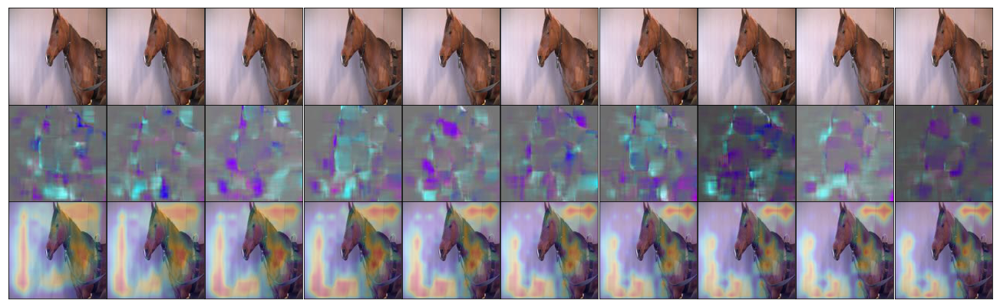

In [15]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  12509
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000816.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000817.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000818.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000819.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000820.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000821.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000822.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000823.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000824.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000825.jpg     1
[[[2.5866348e-01 8.3991647e-01]
  [5.3777717e-02 9.7571701e-01]
  [7.8882817e-03 9.9667251e-01]
  [2.2049693e-03 9.9925989e-01]
  [9.7225211e-04 9.9971980e-01]
  [3.6588550e-04 9.9987423e-01]
  [1.4343797e-04 9.9994516e-01]
  [6.6439265e-05 9.999727

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


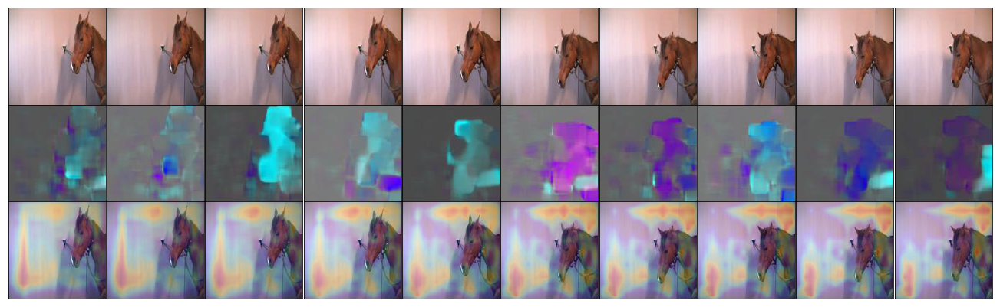

In [16]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2712
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000691.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000692.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000693.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000694.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000695.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000696.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000697.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000698.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000699.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000700.jpg     0
[[[0.35315803 0.64212126]
  [0.28915772 0.76873404]
  [0.23500858 0.8340986 ]
  [0.2647741  0.81629896]
  [0.35736594 0.8191024 ]
  [0.35923713 0.83250445]
  [0.33966494 0.83929944]
  [0.35933545 0.77261406]
  [0.31879407 0.7401177 ]
  [0.40043014 0.7929753 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


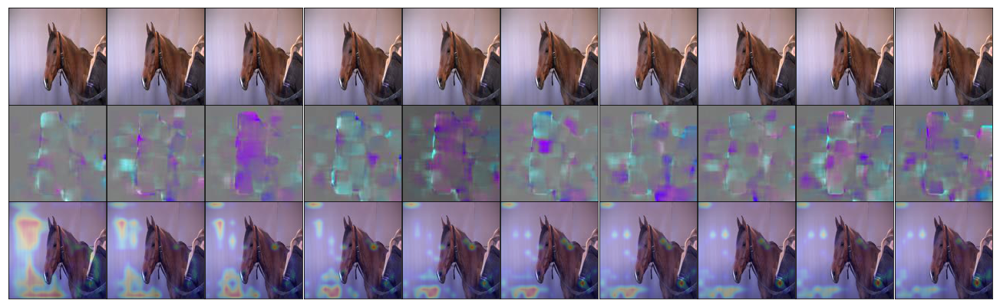

In [17]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  9293
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_001516.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_001517.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_001518.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_001519.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_001520.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_001521.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_001522.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_001523.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_001524.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_001525.jpg     1
[[[1.5881683e-01 8.2609159e-01]
  [2.2804458e-02 9.7692478e-01]
  [4.9375095e-03 9.9467683e-01]
  [2.0838233e-03 9.9726200e-01]
  [1.3554287e-03 9.9676597e-01]
  [8.2368113e-04 9.9347681e-01]
  [5.4893136e-04 9.9268019e-01]
  [4.9638218e-04 9.9457514e-01]
  [4.1761840e-04

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


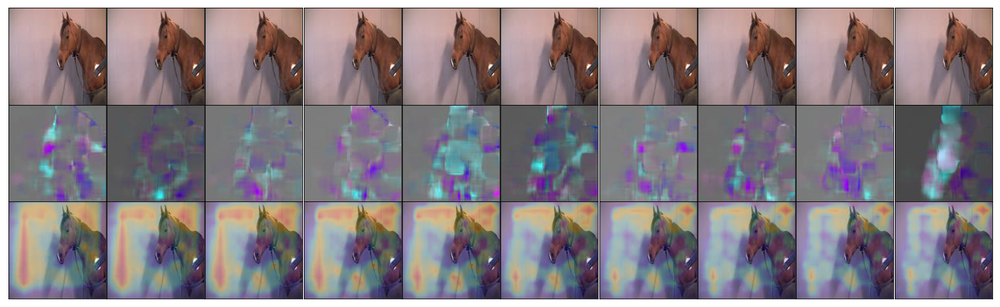

In [18]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  185
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1a/frame_000186.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1a/frame_000187.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1a/frame_000188.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1a/frame_000189.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1a/frame_000190.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1a/frame_000191.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1a/frame_000192.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1a/frame_000193.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1a/frame_000194.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1a/frame_000195.jpg     0
[[[0.5487993  0.4997743 ]
  [0.86908776 0.38356623]
  [0.9703142  0.2921249 ]
  [0.99051815 0.34831074]
  [0.99185526 0.41142696]
  [0.9840201  0.31132084]
  [0.9662931  0.23163071]
  [0.94836265 0.24760893]
  [0.9511193  0.3595456 ]
  [0.96772087 0.37672928]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


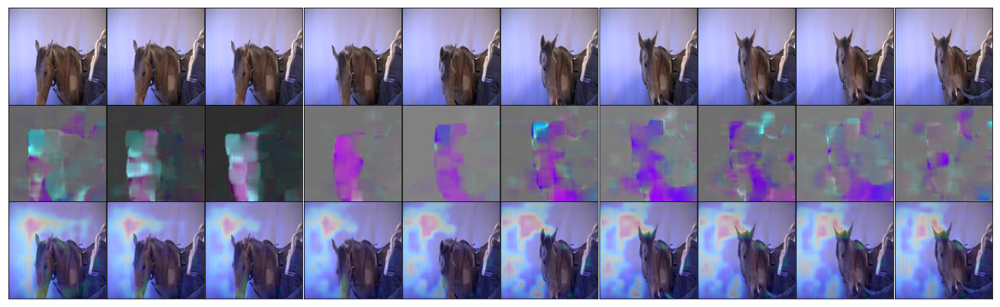

In [19]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  8843
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_001066.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_001067.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_001068.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_001069.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_001070.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_001071.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_001072.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_001073.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_001074.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_001075.jpg     1
[[[0.26274866 0.76644766]
  [0.08358344 0.9480035 ]
  [0.02892536 0.98575145]
  [0.0138277  0.9935268 ]
  [0.01179195 0.9945708 ]
  [0.01678791 0.99474746]
  [0.02243301 0.995596  ]
  [0.03521451 0.99529266]
  [0.06024032 0.9951499 ]
  [0.10460885 0.99374276]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


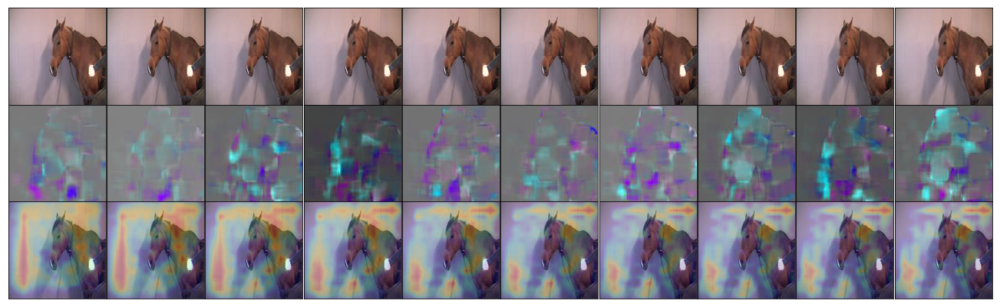

In [20]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  4870
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_2a/frame_001271.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_2a/frame_001272.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_2a/frame_001273.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_2a/frame_001274.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_2a/frame_001275.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_2a/frame_001276.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_2a/frame_001277.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_2a/frame_001278.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_2a/frame_001279.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_2a/frame_001280.jpg     0
[[[4.0679848e-01 4.7909573e-01]
  [4.5552507e-01 1.5344523e-01]
  [6.5682709e-01 1.0750852e-02]
  [8.6047190e-01 1.4391901e-03]
  [9.3988478e-01 4.2065117e-04]
  [9.5669138e-01 2.8235558e-04]
  [9.7269273e-01 3.4975103e-04]
  [9.7634470e-01 4.8024527e-04]
  [9.7323316e-01

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


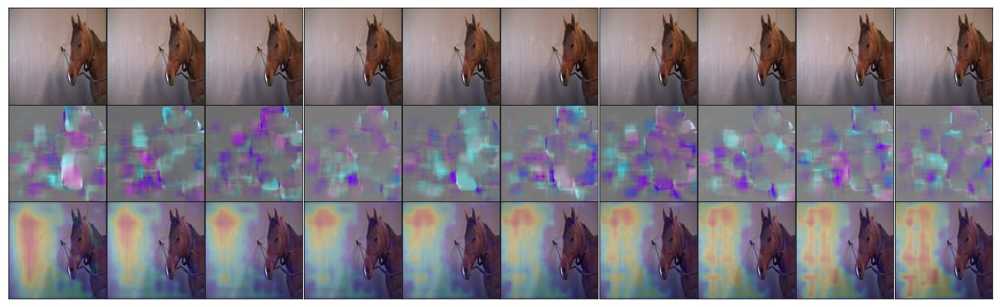

In [21]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  1
Start index in subject dataframe:  3865
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_2/2_2a/frame_000110.jpg     0
1  data/jpg_128_128_2fps/horse_2/2_2a/frame_000111.jpg     0
2  data/jpg_128_128_2fps/horse_2/2_2a/frame_000112.jpg     0
3  data/jpg_128_128_2fps/horse_2/2_2a/frame_000113.jpg     0
4  data/jpg_128_128_2fps/horse_2/2_2a/frame_000114.jpg     0
5  data/jpg_128_128_2fps/horse_2/2_2a/frame_000115.jpg     0
6  data/jpg_128_128_2fps/horse_2/2_2a/frame_000116.jpg     0
7  data/jpg_128_128_2fps/horse_2/2_2a/frame_000117.jpg     0
8  data/jpg_128_128_2fps/horse_2/2_2a/frame_000118.jpg     0
9  data/jpg_128_128_2fps/horse_2/2_2a/frame_000119.jpg     0
[[[5.9859776e-01 2.6685709e-01]
  [8.9954501e-01 5.4841261e-02]
  [9.8721504e-01 1.0853020e-02]
  [9.9677038e-01 5.5412208e-03]
  [9.9875057e-01 2.4671894e-03]
  [9.9918264e-01 1.0471632e-03]
  [9.9908030e-01 4.2658587e-04]
  [9.9855751e-01 2.1328108e-04]
  [9.9825341e-01

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


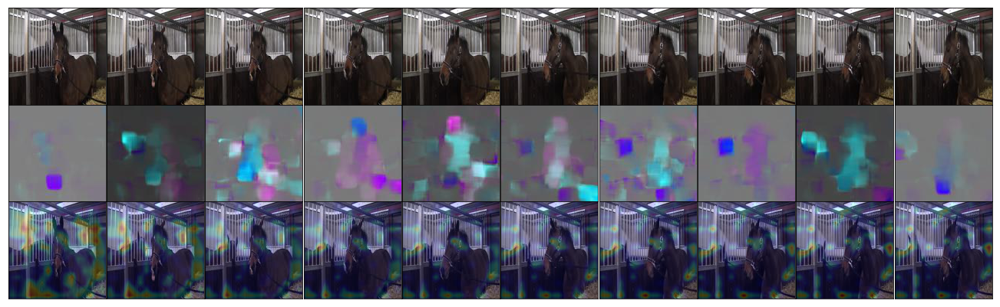

In [22]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=1)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2871
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000850.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000851.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000852.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000853.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000854.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000855.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000856.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000857.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000858.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000859.jpg     0
[[[0.36007085 0.656096  ]
  [0.29435152 0.8128582 ]
  [0.25292668 0.9052315 ]
  [0.20092513 0.95102715]
  [0.15290913 0.9703205 ]
  [0.10905819 0.9802406 ]
  [0.08113372 0.98602796]
  [0.06688422 0.9915358 ]
  [0.06598237 0.9957659 ]
  [0.07351903 0.99732506]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


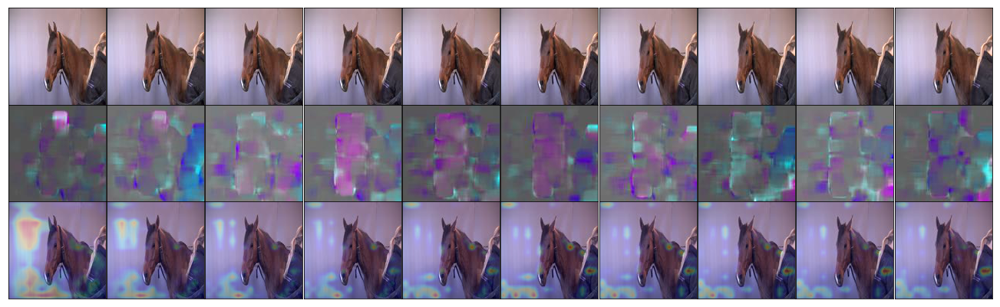

In [23]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  4943
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_2a/frame_001344.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_2a/frame_001345.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_2a/frame_001346.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_2a/frame_001347.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_2a/frame_001348.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_2a/frame_001349.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_2a/frame_001350.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_2a/frame_001351.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_2a/frame_001352.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_2a/frame_001353.jpg     0
[[[4.4012120e-01 4.4503915e-01]
  [4.4594011e-01 9.4127432e-02]
  [6.5055174e-01 4.9517788e-03]
  [8.8979638e-01 7.2180212e-04]
  [9.5644957e-01 3.2497544e-04]
  [9.8207963e-01 2.3936234e-04]
  [9.9208903e-01 2.4156539e-04]
  [9.9391055e-01 2.7494025e-04]
  [9.9458730e-01

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


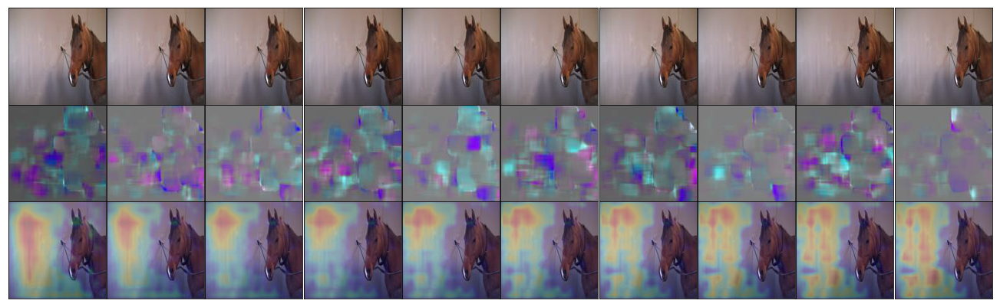

In [24]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  10562
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5a/frame_001071.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5a/frame_001072.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5a/frame_001073.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5a/frame_001074.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5a/frame_001075.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5a/frame_001076.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5a/frame_001077.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5a/frame_001078.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5a/frame_001079.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5a/frame_001080.jpg     1
[[[0.30411637 0.7275331 ]
  [0.12909383 0.9445051 ]
  [0.05222353 0.99061185]
  [0.02969235 0.99845946]
  [0.01775264 0.9994936 ]
  [0.01244067 0.9996995 ]
  [0.01277667 0.9997174 ]
  [0.0150998  0.9996656 ]
  [0.02536097 0.99938583]
  [0.04125758 0.9986706 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


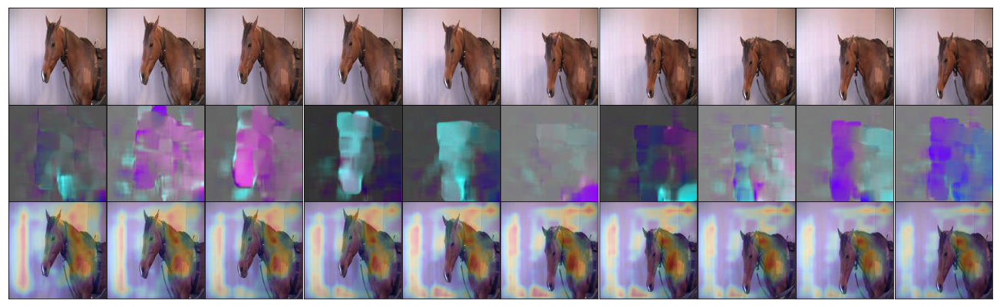

In [25]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  9129
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_001352.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_001353.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_001354.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_001355.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_001356.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_001357.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_001358.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_001359.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_001360.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_001361.jpg     1
[[[2.4251233e-01 7.6758891e-01]
  [3.7653361e-02 9.7479784e-01]
  [6.3613788e-03 9.9745184e-01]
  [2.3787708e-03 9.9927574e-01]
  [1.8280143e-03 9.9980766e-01]
  [1.8185370e-03 9.9986970e-01]
  [2.2665455e-03 9.9989462e-01]
  [1.4296256e-03 9.9988735e-01]
  [7.7902788e-04

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


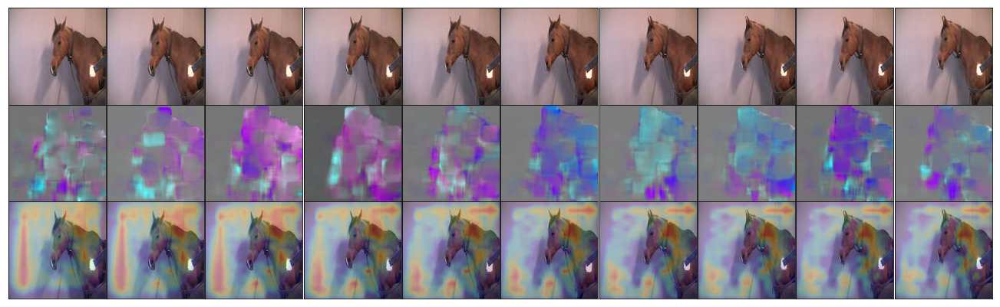

In [26]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  10462
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5a/frame_000971.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5a/frame_000972.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5a/frame_000973.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5a/frame_000974.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5a/frame_000975.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5a/frame_000976.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5a/frame_000977.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5a/frame_000978.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5a/frame_000979.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5a/frame_000980.jpg     1
[[[0.26660538 0.7439162 ]
  [0.08740073 0.94360363]
  [0.02493331 0.9912531 ]
  [0.00908763 0.99795556]
  [0.0097064  0.99895906]
  [0.00975875 0.99903214]
  [0.00985929 0.99884546]
  [0.01148126 0.99874496]
  [0.01651742 0.99885094]
  [0.02296348 0.9983469 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


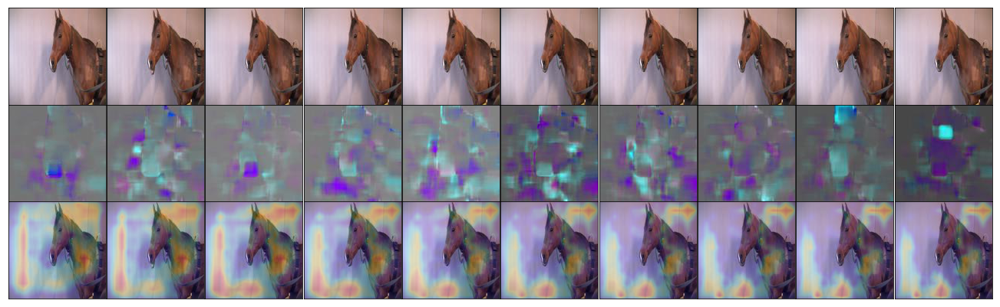

In [27]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  5631
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_2b/frame_000020.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_2b/frame_000021.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_2b/frame_000022.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_2b/frame_000023.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_2b/frame_000024.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_2b/frame_000025.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_2b/frame_000026.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_2b/frame_000027.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_2b/frame_000028.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_2b/frame_000029.jpg     0
[[[3.0042717e-01 5.6211615e-01]
  [2.8745332e-01 4.3810639e-01]
  [5.5870271e-01 1.3103946e-01]
  [8.5650027e-01 2.3298211e-02]
  [9.6455896e-01 5.1629208e-03]
  [9.8697960e-01 1.6429822e-03]
  [9.9677783e-01 6.7586120e-04]
  [9.9845409e-01 4.6057408e-04]
  [9.9885094e-01

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


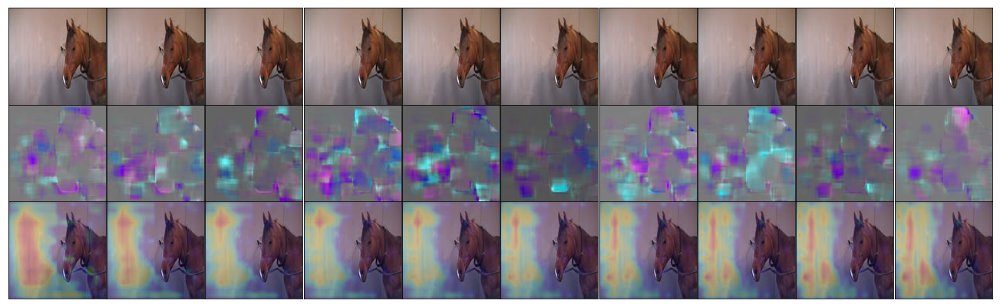

In [28]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2962
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000941.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000942.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000943.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000944.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000945.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000946.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000947.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000948.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000949.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000950.jpg     0
[[[0.56706375 0.5031848 ]
  [0.87242526 0.36365134]
  [0.9759603  0.26609012]
  [0.99163884 0.1823523 ]
  [0.99191296 0.14930157]
  [0.9910486  0.15374826]
  [0.98736876 0.14414465]
  [0.9846028  0.09028855]
  [0.98427504 0.06473862]
  [0.9806482  0.05916187]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


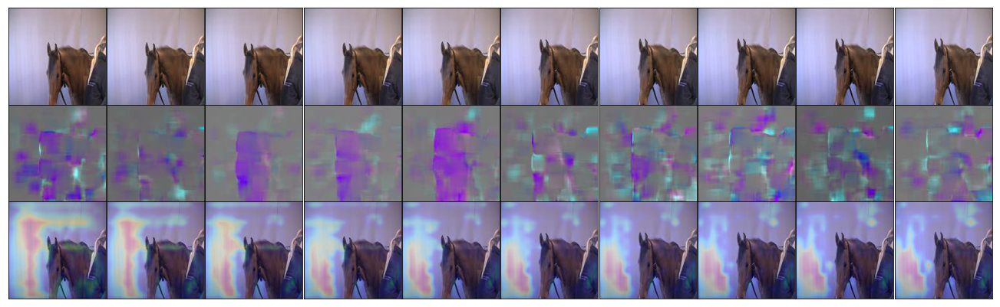

In [29]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  8215
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_000438.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_000439.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_000440.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_000441.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_000442.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_000443.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_000444.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_000445.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_000446.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_000447.jpg     1
[[[1.5158825e-01 8.3673298e-01]
  [1.0270280e-02 9.8311436e-01]
  [1.0626545e-03 9.9787474e-01]
  [1.7577858e-04 9.9949872e-01]
  [4.9155948e-05 9.9968195e-01]
  [1.9007681e-05 9.9962795e-01]
  [1.7911581e-05 9.9949324e-01]
  [3.4384211e-05 9.9939716e-01]
  [7.2581744e-05

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


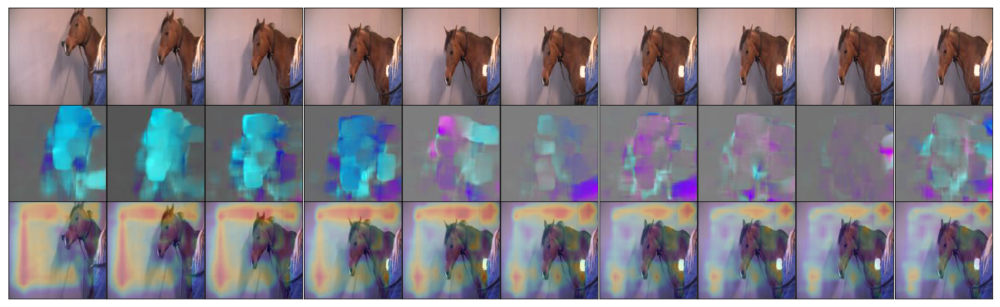

In [30]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  11953
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000260.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000261.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000262.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000263.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000264.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000265.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000266.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000267.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000268.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000269.jpg     1
[[[1.44888252e-01 8.11338902e-01]
  [8.53676442e-03 9.76459801e-01]
  [6.31266914e-04 9.95901883e-01]
  [1.17322525e-04 9.98096406e-01]
  [5.17827102e-05 9.98716831e-01]
  [4.35011862e-05 9.98998106e-01]
  [4.65865269e-05 9.99330401e-01]
  [4.385644

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


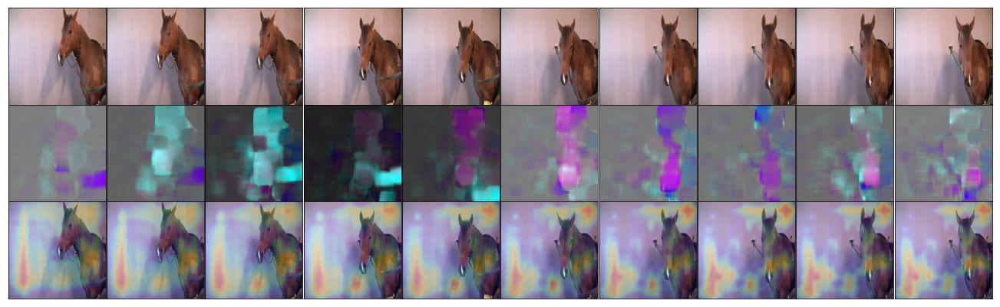

In [31]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  8349
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_000572.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_000573.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_000574.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_000575.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_000576.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_000577.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_000578.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_000579.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_000580.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_000581.jpg     1
[[[2.3449224e-01 7.5414175e-01]
  [3.4984622e-02 9.6703833e-01]
  [5.2280384e-03 9.9554813e-01]
  [1.7118060e-03 9.9760312e-01]
  [1.2453112e-03 9.9645740e-01]
  [1.1661752e-03 9.9541926e-01]
  [1.2196527e-03 9.9457669e-01]
  [9.8770158e-04 9.9545419e-01]
  [5.9364480e-04

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


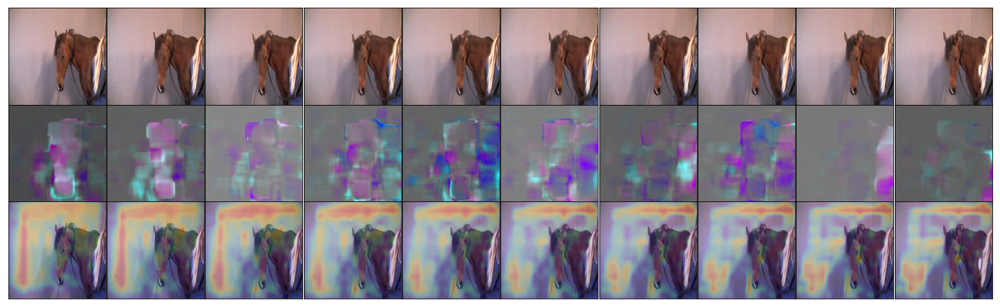

In [32]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  9511
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5a/frame_000020.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5a/frame_000021.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5a/frame_000022.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5a/frame_000023.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5a/frame_000024.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5a/frame_000025.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5a/frame_000026.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5a/frame_000027.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5a/frame_000028.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5a/frame_000029.jpg     1
[[[0.2517306  0.6648026 ]
  [0.13473421 0.7845765 ]
  [0.06094    0.8146285 ]
  [0.02882407 0.81960475]
  [0.02024988 0.84190005]
  [0.01255569 0.89761645]
  [0.0080424  0.93396527]
  [0.00906715 0.9494358 ]
  [0.01218851 0.94509983]
  [0.01907268 0.96165526]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


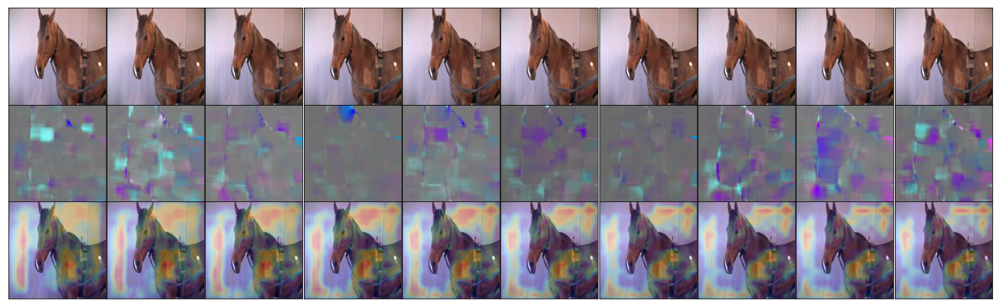

In [33]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  9863
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5a/frame_000372.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5a/frame_000373.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5a/frame_000374.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5a/frame_000375.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5a/frame_000376.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5a/frame_000377.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5a/frame_000378.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5a/frame_000379.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5a/frame_000380.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5a/frame_000381.jpg     1
[[[0.2188611  0.7436508 ]
  [0.04082721 0.9367693 ]
  [0.01105888 0.9819863 ]
  [0.00479791 0.99335045]
  [0.00422978 0.9967692 ]
  [0.00412478 0.99819416]
  [0.00432654 0.9986449 ]
  [0.00350852 0.9983854 ]
  [0.00316619 0.9984465 ]
  [0.0038805  0.9988675 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


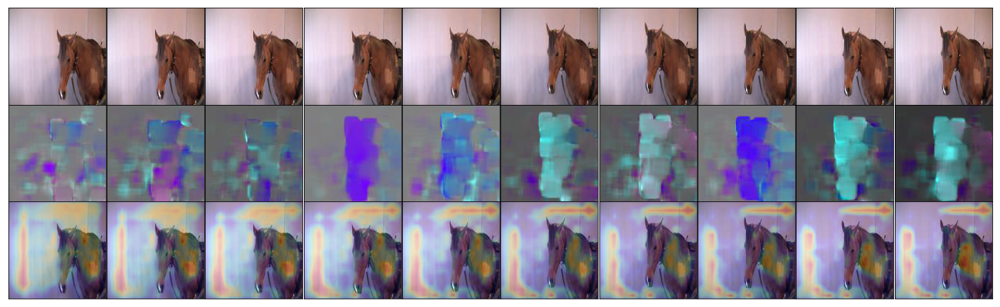

In [34]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  4765
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_2a/frame_001166.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_2a/frame_001167.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_2a/frame_001168.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_2a/frame_001169.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_2a/frame_001170.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_2a/frame_001171.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_2a/frame_001172.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_2a/frame_001173.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_2a/frame_001174.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_2a/frame_001175.jpg     0
[[[0.5510932  0.5384281 ]
  [0.74186206 0.35565835]
  [0.8965073  0.09383847]
  [0.963711   0.0191724 ]
  [0.98374754 0.00615785]
  [0.9903938  0.00334514]
  [0.9928843  0.00310029]
  [0.9939162  0.00493757]
  [0.9928329  0.00479925]
  [0.99026287 0.00494828]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


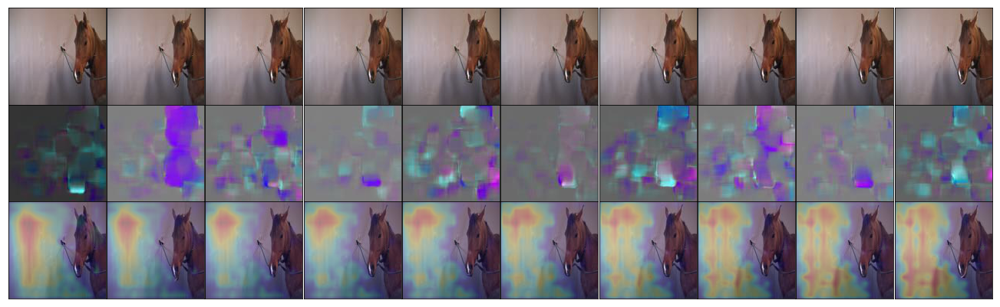

In [35]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  772
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1a/frame_000773.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1a/frame_000774.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1a/frame_000775.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1a/frame_000776.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1a/frame_000777.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1a/frame_000778.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1a/frame_000779.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1a/frame_000780.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1a/frame_000781.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1a/frame_000782.jpg     0
[[[0.4195615  0.5586737 ]
  [0.42073262 0.46317726]
  [0.40570414 0.38546968]
  [0.3625544  0.4873532 ]
  [0.28263372 0.49838045]
  [0.3445184  0.40549296]
  [0.39496806 0.4327587 ]
  [0.41746455 0.49951744]
  [0.42067054 0.6427982 ]
  [0.41073024 0.63474303]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


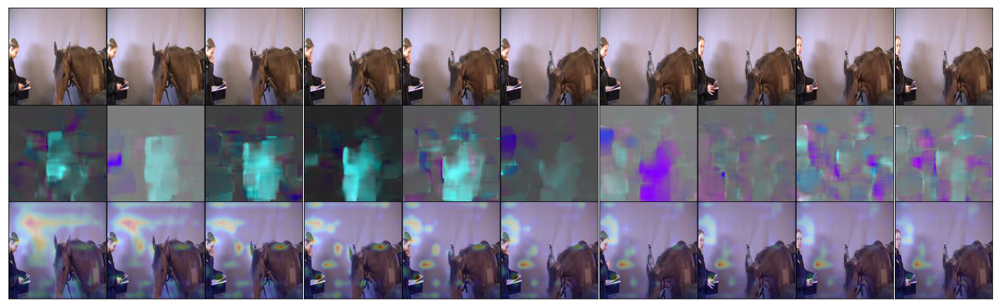

In [36]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2789
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000768.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000769.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000770.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000771.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000772.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000773.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000774.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000775.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000776.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000777.jpg     0
[[[0.38623753 0.6345461 ]
  [0.41709304 0.7233014 ]
  [0.37418926 0.7668931 ]
  [0.3317479  0.78843176]
  [0.23298557 0.7707543 ]
  [0.13522024 0.82277006]
  [0.08448257 0.85517913]
  [0.06174794 0.8775861 ]
  [0.05923679 0.87737215]
  [0.04342789 0.8678275 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


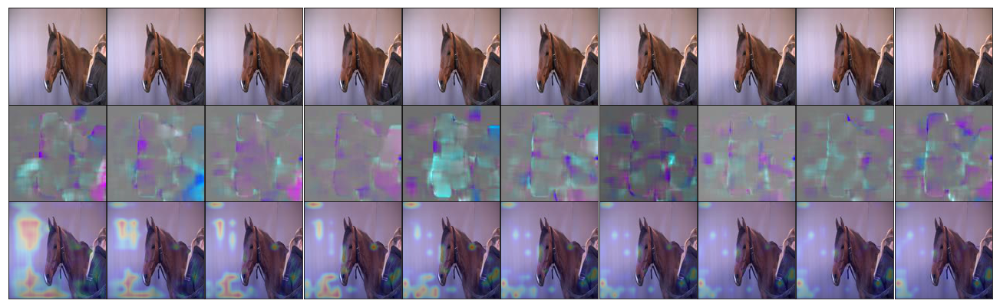

In [37]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2674
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000653.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000654.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000655.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000656.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000657.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000658.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000659.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000660.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000661.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000662.jpg     0
[[[0.38647574 0.58879226]
  [0.39891377 0.6948515 ]
  [0.49875677 0.7374704 ]
  [0.61216307 0.70222145]
  [0.7730365  0.6699347 ]
  [0.8147462  0.7040827 ]
  [0.7783286  0.7087829 ]
  [0.78480107 0.7375469 ]
  [0.79332685 0.7461552 ]
  [0.7845024  0.73075455]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


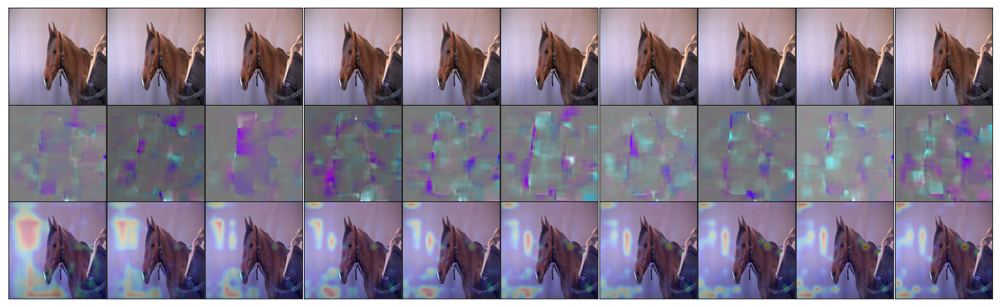

In [38]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  9496
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5a/frame_000005.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5a/frame_000006.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5a/frame_000007.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5a/frame_000008.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5a/frame_000009.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5a/frame_000010.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5a/frame_000011.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5a/frame_000012.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5a/frame_000013.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5a/frame_000014.jpg     1
[[[0.21703222 0.7444104 ]
  [0.03971663 0.91150826]
  [0.00956702 0.9634259 ]
  [0.00489364 0.972693  ]
  [0.00462564 0.97708786]
  [0.00727593 0.9731541 ]
  [0.01267489 0.9520011 ]
  [0.01630155 0.943031  ]
  [0.02204537 0.94315505]
  [0.03326239 0.9257434 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


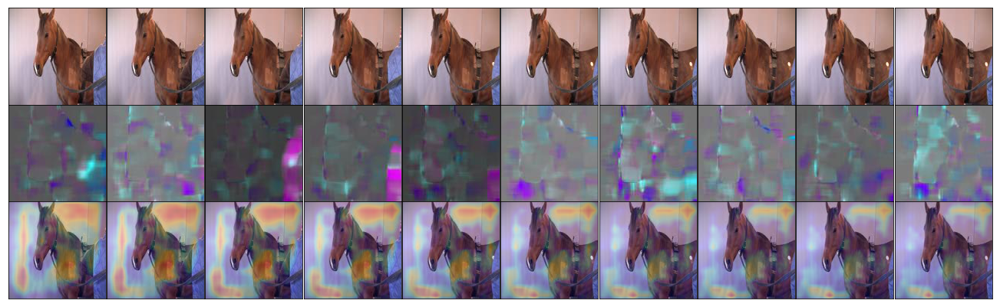

In [39]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2105
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000084.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000085.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000086.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000087.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000088.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000089.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000090.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000091.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000092.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000093.jpg     0
[[[0.40075785 0.48465717]
  [0.42576876 0.44410336]
  [0.5209221  0.51587135]
  [0.6446769  0.6373958 ]
  [0.76457    0.6264149 ]
  [0.81522393 0.5633755 ]
  [0.8649954  0.5070727 ]
  [0.87399304 0.43866876]
  [0.9031188  0.33857283]
  [0.90595776 0.17651977]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


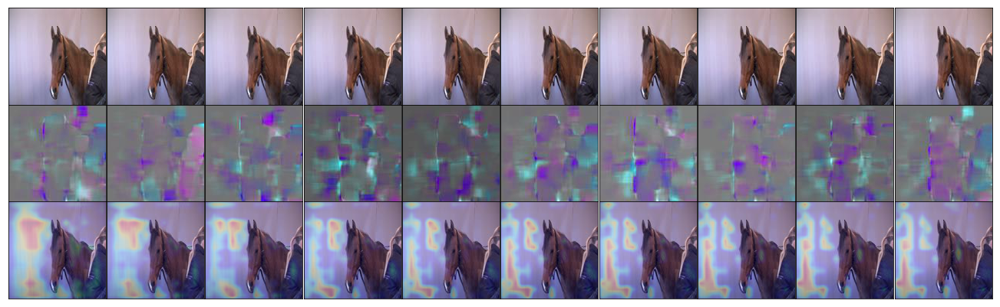

In [40]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  9332
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_001555.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_001556.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_001557.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_001558.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_001559.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_001560.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_001561.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_001562.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_001563.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_001564.jpg     1
[[[1.7781986e-01 7.9677606e-01]
  [2.4891894e-02 9.6876079e-01]
  [3.5790117e-03 9.9497592e-01]
  [8.6110289e-04 9.9859363e-01]
  [4.5840966e-04 9.9939966e-01]
  [4.0265603e-04 9.9956268e-01]
  [4.9131538e-04 9.9952710e-01]
  [5.2824646e-04 9.9948299e-01]
  [6.3184503e-04

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


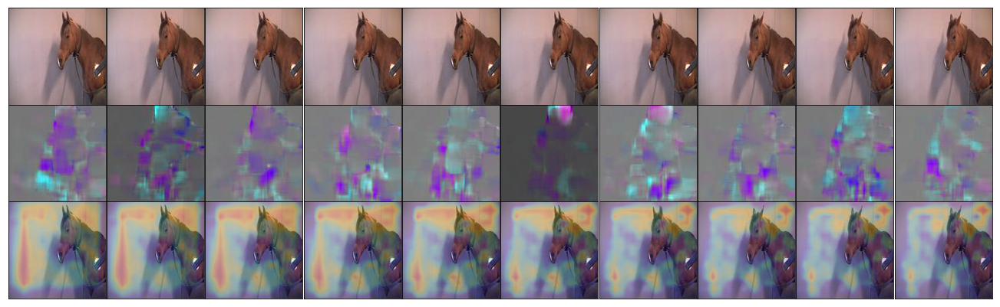

In [41]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  7896
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_4a/frame_000119.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_4a/frame_000120.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_4a/frame_000121.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_4a/frame_000122.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_4a/frame_000123.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_4a/frame_000124.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_4a/frame_000125.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_4a/frame_000126.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_4a/frame_000127.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_4a/frame_000128.jpg     1
[[[0.2291724  0.7272244 ]
  [0.0355933  0.9215421 ]
  [0.00596419 0.96961445]
  [0.00214515 0.97458297]
  [0.0016044  0.9797729 ]
  [0.00142655 0.983652  ]
  [0.00155435 0.9876859 ]
  [0.00184974 0.9863229 ]
  [0.0033276  0.98476136]
  [0.00660455 0.9745008 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


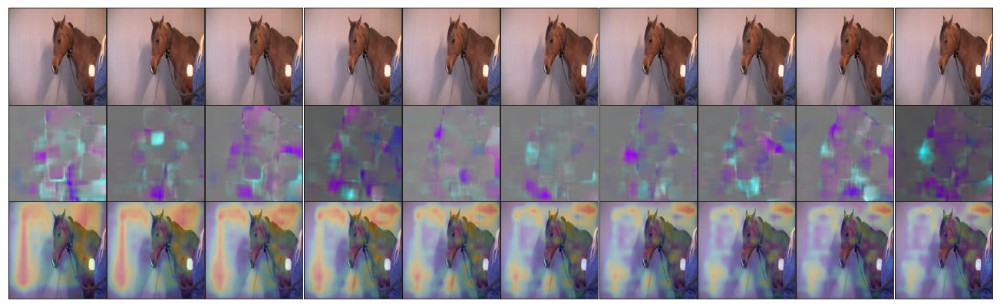

In [42]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2421
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000400.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000401.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000402.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000403.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000404.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000405.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000406.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000407.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000408.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000409.jpg     0
[[[0.34144372 0.5878918 ]
  [0.33924744 0.6295557 ]
  [0.38081422 0.6803935 ]
  [0.32941702 0.75486434]
  [0.26811057 0.82705003]
  [0.21109019 0.8675883 ]
  [0.2476478  0.87288547]
  [0.3280753  0.88026965]
  [0.34234807 0.9155913 ]
  [0.35651052 0.95618474]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


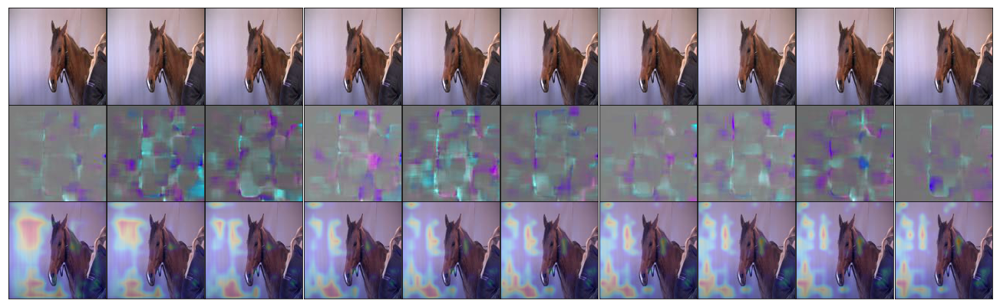

In [43]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  11915
                                                    Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000222.jpg     1
1  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000223.jpg     1
2  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000224.jpg     1
3  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000225.jpg     1
4  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000226.jpg     1
5  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000227.jpg     1
6  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000228.jpg     1
7  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000229.jpg     1
8  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000230.jpg     1
9  data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000231.jpg     1
[[[2.28770256e-01 7.80628979e-01]
  [4.39416319e-02 9.58541095e-01]
  [6.89366832e-03 9.90273654e-01]
  [1.39450526e-03 9.94601488e-01]
  [4.81459225e-04 9.94122446e-01]
  [2.16690067e-04 9.91015494e-01]
  [1.05958905e-04 9.89024818e-01]
  [8.811836

/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


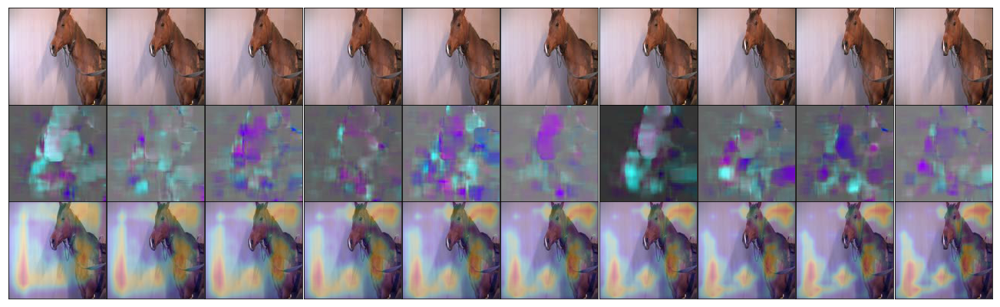

In [44]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  2062
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1b/frame_000041.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1b/frame_000042.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1b/frame_000043.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1b/frame_000044.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1b/frame_000045.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1b/frame_000046.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1b/frame_000047.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1b/frame_000048.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1b/frame_000049.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1b/frame_000050.jpg     0
[[[0.46541137 0.6413068 ]
  [0.5602722  0.7543777 ]
  [0.6143343  0.7765396 ]
  [0.71994114 0.77345574]
  [0.7358046  0.7939221 ]
  [0.6632501  0.84707075]
  [0.5861842  0.89749426]
  [0.4627791  0.9480639 ]
  [0.3972107  0.9667063 ]
  [0.39204893 0.9644252 ]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


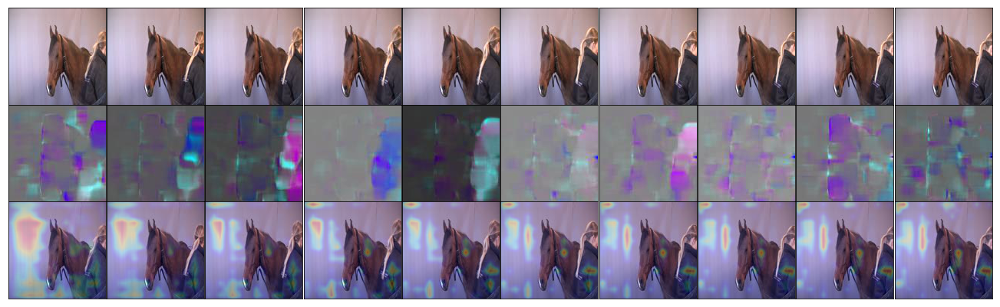

In [45]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);

Chose subject  4
Start index in subject dataframe:  727
                                                  Path  Pain
0  data/jpg_128_128_2fps/horse_5/5_1a/frame_000728.jpg     0
1  data/jpg_128_128_2fps/horse_5/5_1a/frame_000729.jpg     0
2  data/jpg_128_128_2fps/horse_5/5_1a/frame_000730.jpg     0
3  data/jpg_128_128_2fps/horse_5/5_1a/frame_000731.jpg     0
4  data/jpg_128_128_2fps/horse_5/5_1a/frame_000732.jpg     0
5  data/jpg_128_128_2fps/horse_5/5_1a/frame_000733.jpg     0
6  data/jpg_128_128_2fps/horse_5/5_1a/frame_000734.jpg     0
7  data/jpg_128_128_2fps/horse_5/5_1a/frame_000735.jpg     0
8  data/jpg_128_128_2fps/horse_5/5_1a/frame_000736.jpg     0
9  data/jpg_128_128_2fps/horse_5/5_1a/frame_000737.jpg     0
[[[0.43370044 0.4559482 ]
  [0.51406175 0.2907165 ]
  [0.7007444  0.08457198]
  [0.8612402  0.03287636]
  [0.9501507  0.0313317 ]
  [0.9845138  0.04402047]
  [0.99361503 0.06418034]
  [0.99416417 0.07392285]
  [0.9932648  0.07427794]
  [0.99371946 0.07540103]]]


/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/Users/sbroome/miniconda2/envs/py365/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


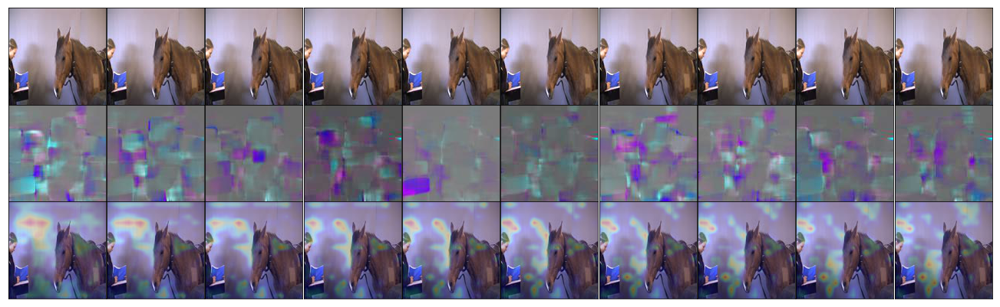

In [46]:
batch_img, batch_flow, batch_label = utils.data_for_one_random_sequence_two_stream(args, subject_dfs, computer='local', subject=4)
run_on_one_sequence(sess, clstm_model, batch_img, batch_flow, two_stream=True);